<a href="https://colab.research.google.com/github/silverho45/DUI-prediction/blob/main/DUI_Prediction_final_Mathmatics_and_Programming.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 위험지역 도출 : K means clustering

In [ ]:
# 모듈 불러오기
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import geopandas as gpd

import folium
from folium.plugins import MarkerCluster

from sklearn.cluster import KMeans

from shapely.geometry import Point

import os

In [ ]:
# 파일 불러오기 : CCTV
# reference : https://data.seoul.go.kr/dataList/OA-20946/A/1/datasetView.do
cctv_df = pd.read_csv("서울시 강남구 안심이 CCTV 연계 현황.csv", encoding="euc-kr")
cctv_df.head()

,자치구,안심 주소,위도,경도,CCTV 수량,수정 일시
0,강남구,삼성1-291-02,37.5148,127.0559,1,2022-12-01
1,강남구,개포1-101-00,37.4866,127.0567,1,2022-12-01
2,강남구,개포1-101-01,37.4866,127.0567,1,2022-12-01
3,강남구,개포1-101-02,37.4866,127.0567,1,2022-12-01
4,강남구,개포1-202-00,37.4834,127.0527,1,2022-12-01


In [ ]:
cctv_gdf = gpd.GeoDataFrame(
    cctv_df,
    geometry=gpd.points_from_xy(cctv_df["경도"], cctv_df["위도"]),
    crs="EPSG:4326"
)

In [ ]:
# 파일 불러오기 : 상가
# refernce : https://www.data.go.kr/data/15083033/fileData.do
store_df = pd.read_csv("소상공인시장진흥공단_상가(상권)정보_서울_202503.csv", encoding="utf-8")
store_df.head()

,상가업소번호,상호명,지점명,상권업종대분류코드,상권업종대분류명,상권업종중분류코드,상권업종중분류명,상권업종소분류코드,상권업종소분류명,표준산업분류코드,...,건물관리번호,건물명,도로명주소,구우편번호,신우편번호,동정보,층정보,호정보,경도,위도
0,MA010120220800000033,부동산임대김은숙,NaN,I2,음식,I212,비알코올,I21201,카페,I56229,...,1111014000100280021026727,NaN,서울특별시 종로구 삼청로 122-1,110230,3053,NaN,NaN,NaN,126.981840,37.586250
1,MA010120220800000036,한국황토건축연구소,NaN,L1,부동산,L102,부동산 서비스,L10203,부동산 중개/대리업,L68221,...,1165010800113080025020133,강남오피스텔,서울특별시 서초구 서초대로73길 40,137856,6612,NaN,11,NaN,127.024563,37.500924
2,MA010120220800000077,소망공인중개사사무소,NaN,L1,부동산,L102,부동산 서비스,L10203,부동산 중개/대리업,L68221,...,1120012200100040011000899,NaN,서울특별시 성동구 용답중앙15길 18,133847,4805,NaN,1,NaN,127.054262,37.564786
3,MA010120220800000084,고향집,NaN,I2,음식,I201,한식,I20101,백반/한정식,I56111,...,1111015400100800000000001,NaN,서울특별시 종로구 돈화문로4길 30,110430,3193,NaN,NaN,NaN,126.993820,37.570025
4,MA010120220800000090,보석나라,NaN,G2,소매,G217,시계·귀금속 소매,G21701,시계/귀금속 소매업,G47830,...,1153010700103590008007958,NaN,서울특별시 구로구 개봉로3길 23,152815,8353,NaN,1,NaN,126.855046,37.486242


In [ ]:
store_gdf = gpd.GeoDataFrame(
    store_df,
    geometry=gpd.points_from_xy(store_df["경도"], store_df["위도"]),
    crs="EPSG:4326"
)

In [ ]:
# 파일 불러오기 : 직장인구
# reference: https://data.seoul.go.kr/dataList/OA-15569/S/1/datasetView.do
worker_df = pd.read_csv("서울시 상권분석서비스(직장인구-상권).csv", encoding="euc-kr")
worker_df.head()

,기준_년분기_코드,상권_구분_코드,상권_구분_코드_명,상권_코드,상권_코드_명,총_직장_인구_수,남성_직장_인구_수,여성_직장_인구_수,연령대_10_직장_인구_수,연령대_20_직장_인구_수,...,남성연령대_30_직장_인구_수,남성연령대_40_직장_인구_수,남성연령대_50_직장_인구_수,남성연령대_60_이상_직장_인구_수,여성연령대_10_직장_인구_수,여성연령대_20_직장_인구_수,여성연령대_30_직장_인구_수,여성연령대_40_직장_인구_수,여성연령대_50_직장_인구_수,여성연령대_60_이상_직장_인구_수
0,20191,A,골목상권,3110160,광진경찰서,312,188,124,1,42,...,46,50,47,22,0,20,32,38,24,10
1,20191,R,전통시장,3130081,자양골목전통시장(자양골목시장),434,340,94,0,29,...,40,95,150,41,0,15,23,24,24,8
2,20191,A,골목상권,3110175,푸른동산공원,419,256,163,0,47,...,62,69,56,41,0,19,26,32,54,32
3,20191,D,발달상권,3120059,구삼강변맛길,2190,1337,853,1,259,...,323,359,284,223,1,111,138,169,265,169
4,20191,A,골목상권,3110105,금동어린이공원,65,32,33,0,6,...,4,8,8,12,0,6,8,8,7,4


In [ ]:
# 파일 불러오기 : 직장인구(위도 경도)
# reference: https://data.seoul.go.kr/dataList/OA-15560/A/1/datasetView.do
gdf = gpd.read_file("서울시 상권분석서비스(영역-상권).shp", encoding="euc-kr")

/usr/local/lib/python3.11/dist-packages/pyogrio/raw.py:198: RuntimeWarning: One or several characters couldn't be converted correctly from euc-kr to UTF-8.  This warning will not be emitted anymore
  return ogr_read(


In [ ]:
gdf["centroid"] = gdf.geometry.centroid

gdf_cent = gpd.GeoDataFrame(gdf, geometry="centroid", crs=gdf.crs)

gdf_cent = gdf_cent.to_crs(epsg=4326)

gdf_cent["lat"] = gdf_cent.geometry.y
gdf_cent["lon"] = gdf_cent.geometry.x

gdf_coords = gdf_cent[["TRDAR_CD", "TRDAR_CD_N", "lat", "lon"]].copy()
gdf_coords.columns = ["상권_코드", "상권_이름", "lat", "lon"]

print(gdf_coords[["lat", "lon"]].describe())

               lat          lon
count  1650.000000  1650.000000
mean     37.548388   126.988492
std       0.050375     0.082383
min      37.435690   126.802015
25%      37.506025   126.918605
50%      37.548064   127.001090
75%      37.581590   127.049338
max      37.689821   127.173769


In [ ]:
gdf_coords["상권_코드"] = gdf_coords["상권_코드"].astype(str)
worker_df["상권_코드"] = worker_df["상권_코드"].astype(str)

worker_geo = pd.merge(worker_df, gdf_coords, on="상권_코드", how="left")

print(worker_geo[["lat", "lon"]].describe())

                lat           lon
count  39276.000000  39276.000000
mean      37.548250    126.988452
std        0.050402      0.082487
min       37.435690    126.802015
25%       37.505449    126.918618
50%       37.547994    127.000693
75%       37.581287    127.049352
max       37.689821    127.173769


In [ ]:
# 파일 불러오기 : 거주인구
# reference : https://www.gangnam.go.kr/board/B_000644/1070938/view.do?mid=ID06_041001

# --------------------------------------------------------------------------------

In [ ]:
# 모듈 불러오기
import pandas as pd
import geopandas as gpd

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import folium

from sklearn.preprocessing import StandardScaler, MinMaxScaler

In [ ]:
# 1. CCTV & Store -> groupby
cctv_df["CCTV"] = 1
store_df["Store"] = 1
cctv_group = cctv_df.groupby(["위도", "경도"])["CCTV"].sum().reset_index()
store_group = store_df.groupby(["위도", "경도"])["Store"].sum().reset_index()

# 2. 직장인구 -> groupby
worker_geo = worker_geo.rename(columns={"lat": "위도", "lon": "경도"})
target_cols = [
    "남성연령대_30_직장_인구_수",
    "남성연령대_40_직장_인구_수",
    "남성연령대_50_직장_인구_수"
]
worker_group = worker_geo.groupby(["위도", "경도"])[target_cols].sum().reset_index()

# 3. 병합 : 좌표(ra,dec) 기준
merged = pd.merge(cctv_group, store_group, on=["위도", "경도"], how="outer")
merged = pd.merge(merged, worker_group, on=["위도", "경도"], how="outer").fillna(0)

# 강남구 범위 필터링
df_gangnam = merged[(merged["위도"] >= 37.46) & (merged["위도"] <= 37.55) &
                (merged["경도"] >= 127.01) & (merged["경도"] <= 127.12)]

In [ ]:
# 4. 위험 요소 계산
df_gangnam["CCTV_score"] = 1 / (1 + df_gangnam["CCTV"])  # CCTV 적으면 위험 ↑
df_gangnam["Store_score"] = np.log1p(df_gangnam["Store"])  # 상점 많으면 위험 ↑


# 위험도 계산
df_gangnam["Worker_score"] = (
    1.0 * df_gangnam["남성연령대_30_직장_인구_수"] +
    1.2 * df_gangnam["남성연령대_40_직장_인구_수"] +
    1.5 * df_gangnam["남성연령대_50_직장_인구_수"]     # 30,40,50대 남성에 높은 가중치
)

# 5. 정규화
scaler = MinMaxScaler()
df_gangnam[["CCTV_score", "Store_score", "Worker_score"]] = scaler.fit_transform(
    df_gangnam[["CCTV_score", "Store_score", "Worker_score"]]
)

# 위험도 계산
df_gangnam["Risk_score"] = (
    0.3 * df_gangnam["CCTV_score"] +
    0.3 * df_gangnam["Store_score"] +
    0.4 * df_gangnam["Worker_score"]  # 직장인구에 높은 가중치
)

# 6. 클러스터링
X = df_gangnam[["CCTV_score", "Store_score", "Worker_score"]]
X_scaled = StandardScaler().fit_transform(X)
kmeans = KMeans(n_clusters=4, random_state=42)
df_gangnam["cluster"] = kmeans.fit_predict(X_scaled)

# --------------------------------------------------------------------------------

In [ ]:
print(df_gangnam[["CCTV_score","Store_score", "Worker_score"]].describe())
print(df_gangnam["cluster"].value_counts())

         CCTV_score   Store_score  Worker_score
count  29851.000000  29851.000000  29851.000000
mean       0.941419      0.185104      0.000572
std        0.214239      0.114390      0.015823
min        0.000000      0.000000      0.000000
25%        1.000000      0.103444      0.000000
50%        1.000000      0.163954      0.000000
75%        1.000000      0.240188      0.000000
max        1.000000      1.000000      1.000000
cluster
1    18203
0     9501
2     2136
3       11
Name: count, dtype: int64


In [ ]:
# 성능 평가
# silhouette score: 1.0 에 가까울 수록 좋은 분리
from sklearn.metrics import silhouette_score

score = silhouette_score(X_scaled, df_gangnam["cluster"])
print(f"Silhouette Score: {score:.3f}")

Silhouette Score: 0.628


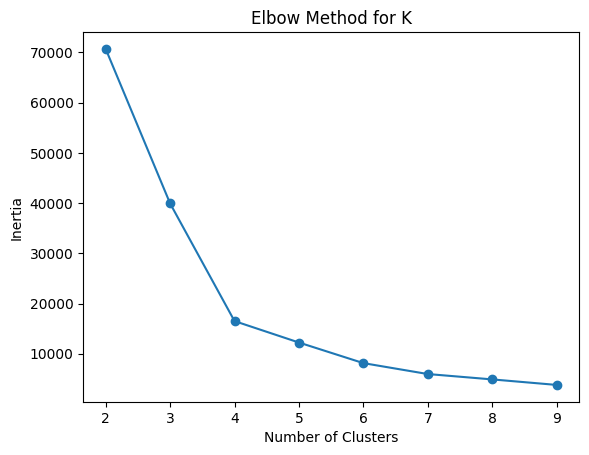

In [ ]:
# 최적 클러스터 수 찾기
# elbow method
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

inertias = []
for k in range(2, 10):
    model = KMeans(n_clusters=k, random_state=42)
    model.fit(X_scaled)
    inertias.append(model.inertia_)

plt.plot(range(2, 10), inertias, marker="o")
plt.xlabel("Number of Clusters")
plt.ylabel("Inertia")
plt.title("Elbow Method for K")
plt.show()

# --------------------------------------------------------------------------------

In [ ]:
summary = df_gangnam.groupby("cluster")["Risk_score"].mean().sort_values(ascending=False)
print(summary)

cluster
3    0.592212
0    0.394326
1    0.342031
2    0.054397
Name: Risk_score, dtype: float64


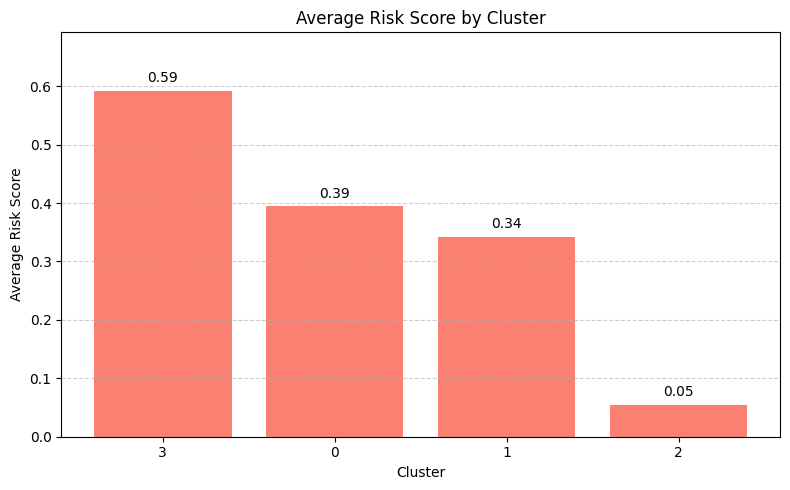

In [ ]:
avg_risk_by_cluster = df_gangnam.groupby("cluster")["Risk_score"].mean().sort_values(ascending=False)

plt.figure(figsize=(8, 5))
bars = plt.bar(avg_risk_by_cluster.index.astype(str), avg_risk_by_cluster.values, color="salmon")

for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height + 0.01, f"{height:.2f}", ha="center", va="bottom")

# Labels and title
plt.xlabel("Cluster")
plt.ylabel("Average Risk Score")
plt.title("Average Risk Score by Cluster")
plt.ylim(0, avg_risk_by_cluster.max() + 0.1)
plt.grid(axis="y", linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

In [ ]:
# 지도 시각화(1)
colors = ["red", "blue","green","grey"]

center = [37.5, 127.03]
m = folium.Map(location=center, zoom_start=13)

for _, row in df_gangnam.iterrows():
    folium.CircleMarker(
        location=[row["위도"], row["경도"]],
        radius=3,
        color=colors[int(row["cluster"]) % len(colors)],
        fill=True,
        fill_opacity=0.8
    ).add_to(m)

m

In [ ]:
# 지도 시각화(2)
from folium.plugins import HeatMap
import folium

m = folium.Map(location=[37.5, 127.03], zoom_start=13)

heat_data = df_gangnam[["위도", "경도", "Risk_score"]].dropna().values.tolist()

HeatMap(heat_data, radius=10, blur=7, max_zoom=13).add_to(m)

m

In [ ]:
# 원본 지도 (비교용)
m = folium.Map(location=[37.5, 127.03], zoom_start=13)
m